The primary objective of this competition is to employ deep learning-based regression models, such as Convolutional Neural Networks (CNNs) like ConvNext or Transformers, to predict plant traits from photographs. These plant traits, although available for each image, may not yield exceptionally high accuracies due to the inherent heterogeneity of citizen science data. The various plant traits describe chemical tissue properties that are loosely related to the visible appearance of plants in images. Despite the anticipated moderate accuracies, the overarching goal is to explore the potential of this approach and gain insights into global changes affecting ecosystems. Your contribution to uncovering the wealth of data and the distribution of plant traits worldwide is invaluable.

Our goal is to predict a broad set of 6 plant traits (e.g. leaf area, plant height) from crowd-sourced plant images and some ancillary data. 

The models will be evaluated against the independent test data. The evaluation metric for this competition is the mean R2 over all 6 traits. The R2 is commonly used for evaluating regression models and is the ratio of the sum of squares the residuals (SSres) to the total sum of squares (SStot).

The R2 can result in large negative values. To prevent that we will only consider R2 values > 0.

The submission should include a .csv file with a prediction for each trait and the following columns: id (see labels) and a prediction for each trait (X1080, X50, …). An example is given with sample_submission.csv


- Notebook modified from https://www.kaggle.com/code/markwijkhuizen/planttraits2024-eda-training-pub.

# Imports

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import imageio.v3 as imageio
import albumentations as A

from albumentations.pytorch import ToTensorV2
from torch.utils.data import Dataset, DataLoader
from torch import nn
from torchvision import transforms
from tqdm.notebook import tqdm
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

import torch
import timm
import glob
import torchmetrics
import time
import psutil
import os
import math
import warnings


tqdm.pandas()

# Config

In [2]:
class Config():
    IMAGE_SIZE0 = 512
    IMAGE_SIZE = 288
    BACKBONE = 'efficientvit_b1.r288_in1k'#'swin_large_patch4_window12_384.ms_in22k_ft_in1k'
    TARGET_COLUMNS = ['X4_mean', 'X11_mean', 'X18_mean', 'X50_mean', 'X26_mean', 'X3112_mean']
    TARGET_COLUMNS_TEST = ['X4', 'X11', 'X18', 'X50', 'X26', 'X3112']
    N_TARGETS = len(TARGET_COLUMNS)
    #Dataset
    RECOMPUTE_DATAFRAME = False
    BATCH_SIZE = 24
    BATCH_SIZE_VAL = 128
    N_VAL_SAMPLES0 = 4096

    #Training
    LR_MAX = 1e-4
    WEIGHT_DECAY = 0.01
    N_EPOCHS = 12
    TRAIN_MODEL = True

    #Others
    IS_INTERACTIVE = False #os.environ['KAGGLE_KERNEL_RUN_TYPE'] == 'Interactive'
    SEED = 42
    EPS = 1e-6 
    DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    EPS_CUDA = torch.tensor(EPS).to(DEVICE)
        
CONFIG = Config()

In [4]:
if CONFIG.RECOMPUTE_DATAFRAME:
    train0 = pd.read_csv('Documents/GitHub/CS5242 Neural Networks/CS5242_plantTraits/data/train.csv')
    train0['file_path'] = train0['id'].apply(lambda s: f'Documents/GitHub/CS5242 Neural Networks/CS5242_plantTraits/data/train_images/{s}.jpeg')
    train0['jpeg_bytes'] = train0['file_path'].progress_apply(lambda fp: open(fp, 'rb').read())
    train0.to_pickle('Documents/GitHub/CS5242 Neural Networks/CS5242_plantTraits/data/train.pkl')

    test = pd.read_csv('Documents/GitHub/CS5242 Neural Networks/CS5242_plantTraits/data/test.csv')
    test['file_path'] = test['id'].apply(lambda s: f'Documents/GitHub/CS5242 Neural Networks/CS5242_plantTraits/data/test_images/{s}.jpeg')
    test['jpeg_bytes'] = test['file_path'].progress_apply(lambda fp: open(fp, 'rb').read())
    test.to_pickle('Documents/GitHub/CS5242 Neural Networks/CS5242_plantTraits/data/test.pkl')

else:
    train0 = pd.read_pickle('/Users/dlkh/Documents/GitHub/CS5242 Neural Networks/CS5242_plantTraits/data/train.pkl')
    test = pd.read_pickle('/Users/dlkh/Documents/GitHub/CS5242 Neural Networks/CS5242_plantTraits/data/test.pkl')

CONFIG.TARGET_MEDIANS = train0[CONFIG.TARGET_COLUMNS].median(axis=0).values

# Setup Train/Test dataframes

In [5]:
# Split train in train/val
train, val = train_test_split(train0, test_size=CONFIG.N_VAL_SAMPLES0, shuffle=True, random_state=CONFIG.SEED)

train = train.reset_index(drop=True)
val = val.reset_index(drop=True)
    
# Display DataFrame
display(train.head(30))
display(train.info())

display(test.head())
display(test.info())

,id,WORLDCLIM_BIO1_annual_mean_temperature,WORLDCLIM_BIO12_annual_precipitation,WORLDCLIM_BIO13.BIO14_delta_precipitation_of_wettest_and_dryest_month,WORLDCLIM_BIO15_precipitation_seasonality,WORLDCLIM_BIO4_temperature_seasonality,WORLDCLIM_BIO7_temperature_annual_range,SOIL_bdod_0.5cm_mean_0.01_deg,SOIL_bdod_100.200cm_mean_0.01_deg,SOIL_bdod_15.30cm_mean_0.01_deg,...,X50_mean,X3112_mean,X4_sd,X11_sd,X18_sd,X26_sd,X50_sd,X3112_sd,file_path,jpeg_bytes
0,196624290,16.648258,404.545929,87.642860,101.176125,424.887177,26.180101,139,166,156,...,1.851404,2245.603152,0.002085,0.187827,0.064559,0.065326,0.030949,88.683653,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
1,196189742,13.411370,1136.826660,234.182220,94.147125,332.503937,18.968889,116,144,130,...,1.711225,489.488277,0.003707,0.424258,0.017467,0.192608,0.018882,23.418026,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
2,194460461,9.295298,645.719055,31.271429,20.844044,751.378235,28.223808,123,146,131,...,0.934460,476.389699,0.005200,0.792265,0.139783,0.011707,0.019554,45.876232,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
3,93537648,26.872620,847.530640,198.357147,100.623215,59.281303,12.264285,134,146,141,...,1.583896,2741.958201,NaN,NaN,NaN,NaN,NaN,NaN,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
4,160706420,22.923363,776.178589,193.000000,107.569908,268.802460,20.789286,136,145,141,...,0.987728,425.886697,0.002632,0.157741,0.019281,0.003622,0.004140,21.761224,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
5,194415760,15.784444,678.228577,58.042858,26.687412,531.877075,26.029047,120,143,135,...,1.251206,121.257077,0.014481,7.614656,0.355474,0.890135,0.395452,40.280877,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
6,193961380,13.733074,1226.208862,170.395554,58.283901,547.907349,24.488445,115,148,128,...,1.157245,92.537923,0.004831,0.321849,0.007330,0.005784,0.016218,0.167107,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
7,151679655,15.819907,379.911102,44.195557,46.428082,453.146698,24.776443,120,146,136,...,0.910560,82.402497,NaN,NaN,NaN,NaN,NaN,NaN,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
8,195887605,22.843601,73.142860,11.500000,56.059990,726.718933,34.696430,132,149,145,...,3.464295,837.110254,0.002787,0.493559,0.154642,2.740377,0.130676,124.563503,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
9,194615980,8.617071,908.489807,45.000000,19.598837,942.301392,36.777042,122,164,140,...,1.056573,25745.366272,0.003985,0.608635,0.308903,0.546754,0.008992,12839.121551,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51393 entries, 0 to 51392
Columns: 178 entries, id to jpeg_bytes
dtypes: float64(54), int64(122), object(2)
memory usage: 69.8+ MB


None

,id,WORLDCLIM_BIO1_annual_mean_temperature,WORLDCLIM_BIO12_annual_precipitation,WORLDCLIM_BIO13.BIO14_delta_precipitation_of_wettest_and_dryest_month,WORLDCLIM_BIO15_precipitation_seasonality,WORLDCLIM_BIO4_temperature_seasonality,WORLDCLIM_BIO7_temperature_annual_range,SOIL_bdod_0.5cm_mean_0.01_deg,SOIL_bdod_100.200cm_mean_0.01_deg,SOIL_bdod_15.30cm_mean_0.01_deg,...,VOD_X_1997_2018_multiyear_mean_m05,VOD_X_1997_2018_multiyear_mean_m06,VOD_X_1997_2018_multiyear_mean_m07,VOD_X_1997_2018_multiyear_mean_m08,VOD_X_1997_2018_multiyear_mean_m09,VOD_X_1997_2018_multiyear_mean_m10,VOD_X_1997_2018_multiyear_mean_m11,VOD_X_1997_2018_multiyear_mean_m12,file_path,jpeg_bytes
0,201238668,8.086756,2246.500000,127.321426,20.423418,353.381042,17.535713,80,109,90,...,0.387536,0.374910,0.363712,0.364623,0.379435,0.388294,0.398887,0.397853,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
1,202310319,10.844286,495.871429,28.023809,18.738306,786.554382,29.292856,130,155,142,...,0.332776,0.314386,0.291168,0.280947,0.277623,0.276503,0.271212,0.272672,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
2,202604412,8.105556,378.328583,39.928570,41.885647,722.071167,34.853809,133,134,139,...,0.437172,0.453239,0.445230,0.435441,0.432758,0.429839,0.417250,0.394216,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
3,201353439,7.077679,878.785706,70.428574,37.045235,669.389343,25.150000,103,140,116,...,0.352311,0.401131,0.513455,0.519174,0.474007,0.469071,0.408466,0.366724,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
4,195351745,4.790555,2299.366699,150.199997,24.136568,462.887695,22.516666,85,114,98,...,0.462181,0.397052,0.358262,0.369279,0.414420,0.469002,0.519534,0.521837,Documents/GitHub/CS5242 Neural Networks/CS5242...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6545 entries, 0 to 6544
Columns: 166 entries, id to jpeg_bytes
dtypes: float64(42), int64(122), object(2)
memory usage: 8.3+ MB


None

the train dataset consists of 176 data parameters and 55489 images with tabulated data,
the test dataset consists of 164 data parameters and 13873 images with tabulated data.

the discrepancy between the train and test dataset comes from the following 12 parameters missing from the test dataset:

['X11_sd', 'X26_sd', 'X26_mean', 'X50_sd', 'X50_mean', 'X3112_sd', 'X4_mean', 'X18_mean', 'X18_sd', 'X11_mean', 'X3112_mean', 'X4_sd']

these parameters are missing because they are meant to be estimated using the model

In [6]:
#Feature columns
FEATURE_COLUMNS = test.columns.values[1:-2]
CONFIG.N_FEATURES = len(FEATURE_COLUMNS)
print('N_FEATURES:', CONFIG.N_FEATURES)

#Min/Max values based on 0.1% and 99.9% quantiles
CONFIG.V_MIN = train[CONFIG.TARGET_COLUMNS].quantile(0.001)
CONFIG.V_MAX = train[CONFIG.TARGET_COLUMNS].quantile(0.999)

sample_submission = pd.read_csv('/Users/dlkh/Documents/GitHub/CS5242 Neural Networks/CS5242_plantTraits/data/sample_submission.csv')

display(sample_submission.head())
display(sample_submission.info())

N_FEATURES: 163


,id,X4,X11,X18,X50,X26,X3112
0,201238668,21.228750,46.704747,31.430122,14.088638,24.208952,93.351051
1,202310319,4.938497,71.644437,50.208404,99.503446,86.561125,20.325735
2,202604412,34.268159,93.046483,74.556941,84.275746,85.713291,23.470287
3,201353439,48.213879,84.687775,-1.442158,-9.852137,13.327949,-0.274766
4,195351745,55.117501,87.046172,84.335483,79.218376,19.142174,11.294033


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5 entries, 0 to 4
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   id      5 non-null      int64  
 1   X4      5 non-null      float64
 2   X11     5 non-null      float64
 3   X18     5 non-null      float64
 4   X50     5 non-null      float64
 5   X26     5 non-null      float64
 6   X3112   5 non-null      float64
dtypes: float64(6), int64(1)
memory usage: 408.0 bytes


None

In [7]:
train[CONFIG.TARGET_COLUMNS].quantile(0.001)

X4_mean      -0.416011
X11_mean      0.516698
X18_mean      0.005098
X50_mean      0.056425
X26_mean      0.001079
X3112_mean    1.132863
Name: 0.001, dtype: float64

# Test Example Images

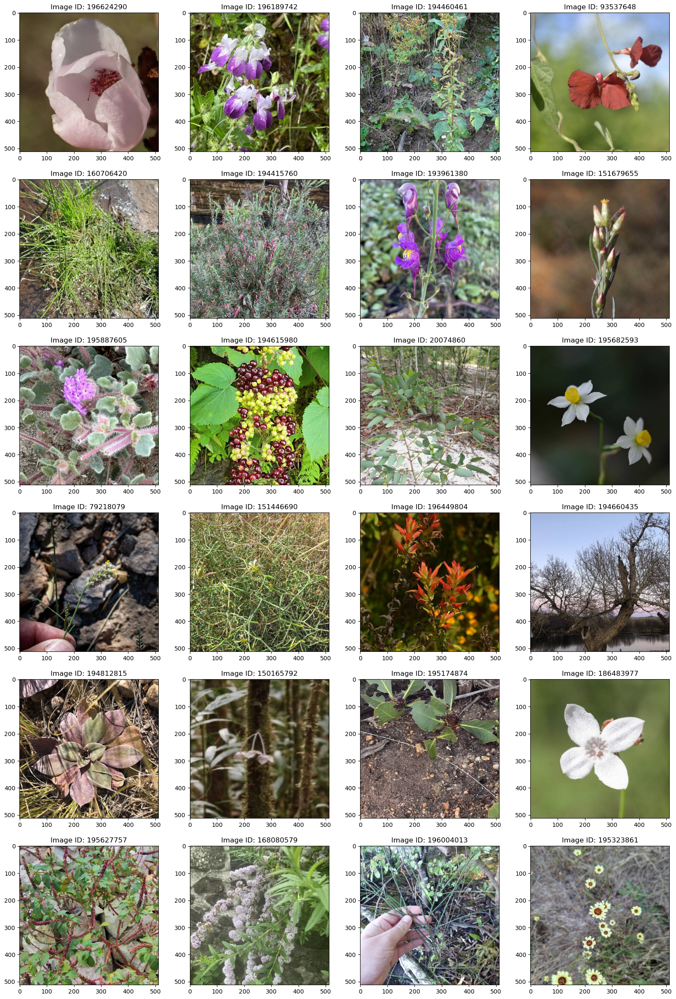

In [8]:
def plot_example(nrows=6, ncols=4):
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols*5, nrows*5))
    for r in range(nrows):
        for c in range(ncols):
            idx = (r * ncols) + c
            img = imageio.imread(train['jpeg_bytes'][idx])
            image_id = train['id'][idx]
            axes[r, c].imshow(img)
            axes[r, c].set_title(f'Image ID: {image_id}')
            
    plt.show()
    
plot_example()

# Plot Tabular datasets

In [14]:
filtered_climate = [col for col in train.columns if col.startswith('WORLDCLIM_BIO')]
filtered_soil = [col for col in train.columns if col.startswith('SOIL_')]
filtered_MODIS = [col for col in train.columns if col.startswith('MODIS_')]
filtered_VOD = [col for col in train.columns if col.startswith('VOD_')]

total = 0
for columns in [filtered_climate, filtered_soil, filtered_MODIS, filtered_VOD]:
    print(len(columns))
    total += len(columns)
print(f"Total feature columns: {total}")

6
61
60
36
Total feature columns: 163


In [16]:
climate_cols_df = train[filtered_climate]
soil_cols_df = train[filtered_soil]
MODIS_cols_df = train[filtered_MODIS]
VOD_cols_df = train[filtered_VOD]

# Climate Data Analysis

In [19]:
display(climate_cols_df.head())
display(climate_cols_df.info())
display(climate_cols_df.describe().T)

,WORLDCLIM_BIO1_annual_mean_temperature,WORLDCLIM_BIO12_annual_precipitation,WORLDCLIM_BIO13.BIO14_delta_precipitation_of_wettest_and_dryest_month,WORLDCLIM_BIO15_precipitation_seasonality,WORLDCLIM_BIO4_temperature_seasonality,WORLDCLIM_BIO7_temperature_annual_range
0,16.648258,404.545929,87.642860,101.176125,424.887177,26.180101
1,13.411370,1136.826660,234.182220,94.147125,332.503937,18.968889
2,9.295298,645.719055,31.271429,20.844044,751.378235,28.223808
3,26.872620,847.530640,198.357147,100.623215,59.281303,12.264285
4,22.923363,776.178589,193.000000,107.569908,268.802460,20.789286


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51393 entries, 0 to 51392
Data columns (total 6 columns):
 #   Column                                                                 Non-Null Count  Dtype  
---  ------                                                                 --------------  -----  
 0   WORLDCLIM_BIO1_annual_mean_temperature                                 51393 non-null  float64
 1   WORLDCLIM_BIO12_annual_precipitation                                   51393 non-null  float64
 2   WORLDCLIM_BIO13.BIO14_delta_precipitation_of_wettest_and_dryest_month  51393 non-null  float64
 3   WORLDCLIM_BIO15_precipitation_seasonality                              51393 non-null  float64
 4   WORLDCLIM_BIO4_temperature_seasonality                                 51393 non-null  float64
 5   WORLDCLIM_BIO7_temperature_annual_range                                51393 non-null  float64
dtypes: float64(6)
memory usage: 2.4 MB


None

,count,mean,std,min,25%,50%,75%,max
WORLDCLIM_BIO1_annual_mean_temperature,51393.0,14.577227,7.579329,-13.731130,9.249702,15.520389,20.242460,30.294445
WORLDCLIM_BIO12_annual_precipitation,51393.0,1058.266328,768.482333,0.000000,527.733337,853.698975,1351.980957,6852.163086
WORLDCLIM_BIO13.BIO14_delta_precipitation_of_wettest_and_dryest_month,51393.0,138.092550,136.250227,0.000000,53.000000,95.474487,181.195236,2309.071533
WORLDCLIM_BIO15_precipitation_seasonality,51393.0,56.724500,31.683829,0.000000,29.715101,50.219654,80.872429,169.582291
WORLDCLIM_BIO4_temperature_seasonality,51393.0,518.799190,316.330539,9.877081,300.717651,447.248016,689.922302,2025.894653
WORLDCLIM_BIO7_temperature_annual_range,51393.0,25.228421,9.143717,7.658674,18.819899,23.695715,30.373810,63.657616


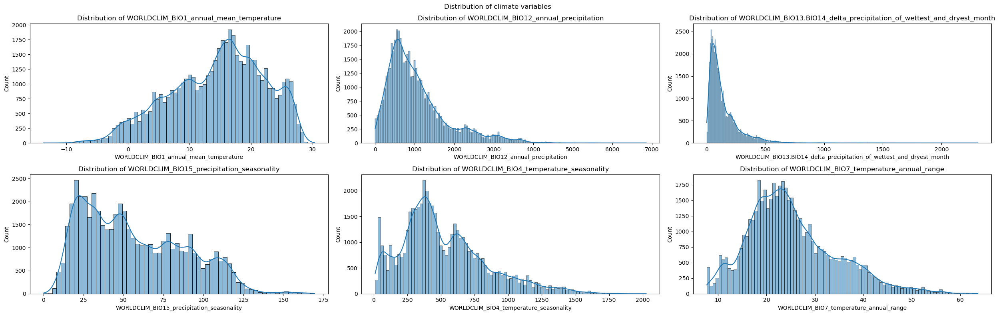

In [20]:
import seaborn as sns
# just ignore the warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=FutureWarning)

    fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(25, 8))
    fig.suptitle("Distribution of climate variables")
    for i, target_name in enumerate(climate_cols_df.columns):
        sns.histplot(data=climate_cols_df, x=target_name, ax=axes[i // 3, i % 3], kde=True)
        axes[i // 3, i % 3].set_title(f"Distribution of {target_name}")

    plt.tight_layout()
    plt.show()

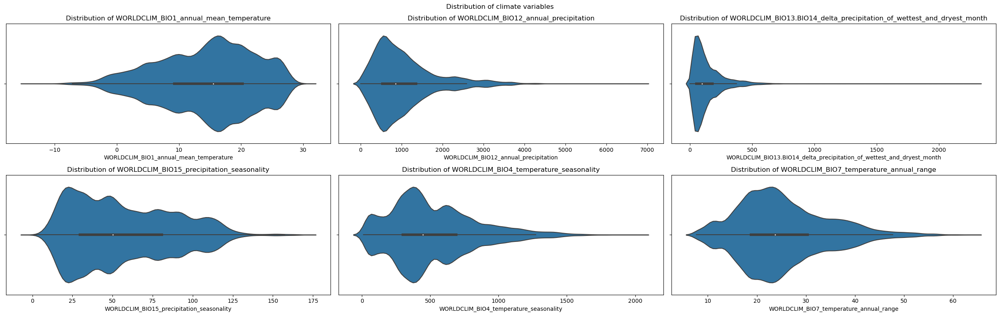

In [22]:


import warnings
# just ignore the warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=FutureWarning)

    fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(25, 8))
    fig.suptitle("Distribution of climate variables")
    for i, target_name in enumerate(climate_cols_df.columns):
        sns.violinplot(data=climate_cols_df, x=target_name, ax=axes[i // 3, i % 3])
        axes[i // 3, i % 3].set_title(f"Distribution of {target_name}")

    plt.tight_layout()
    plt.show()



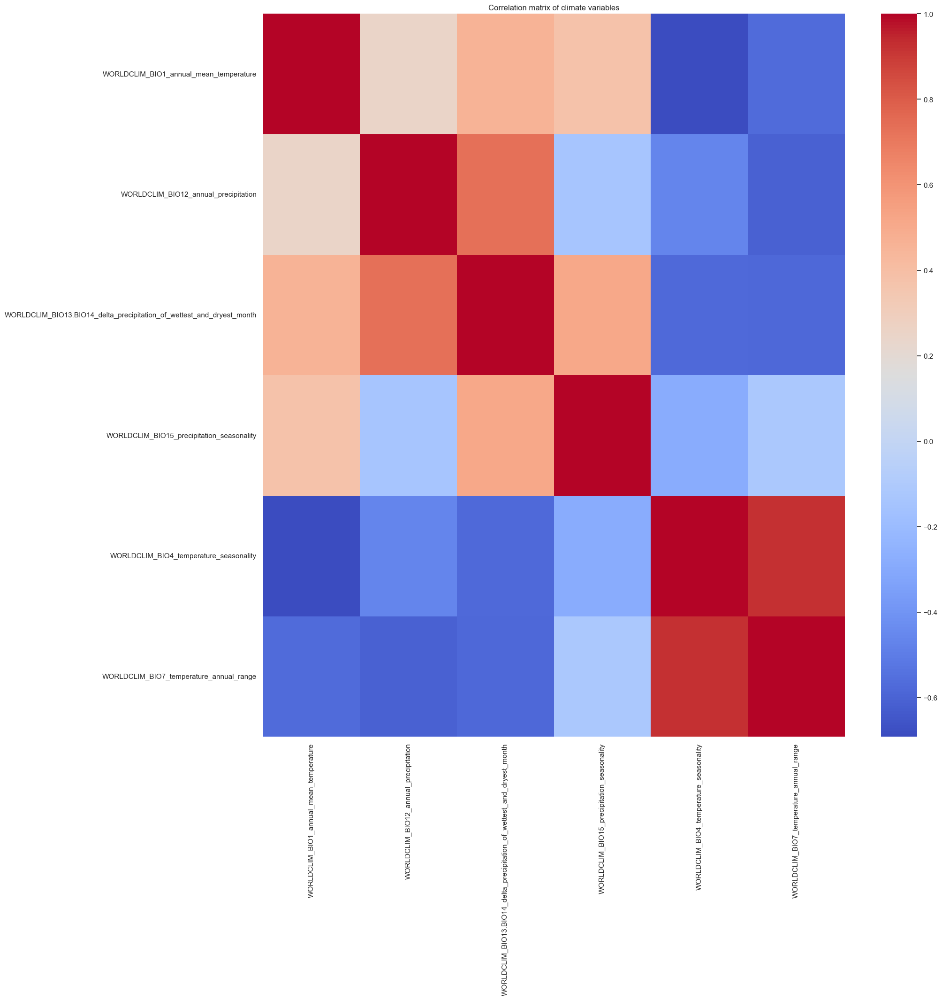

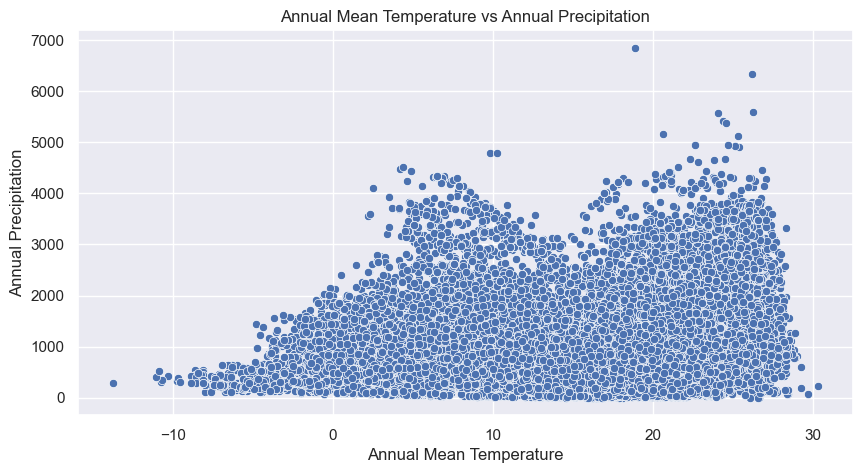

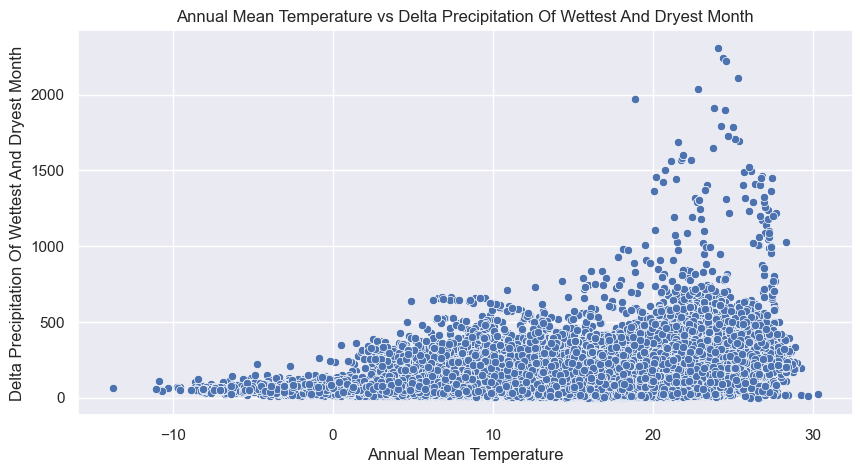

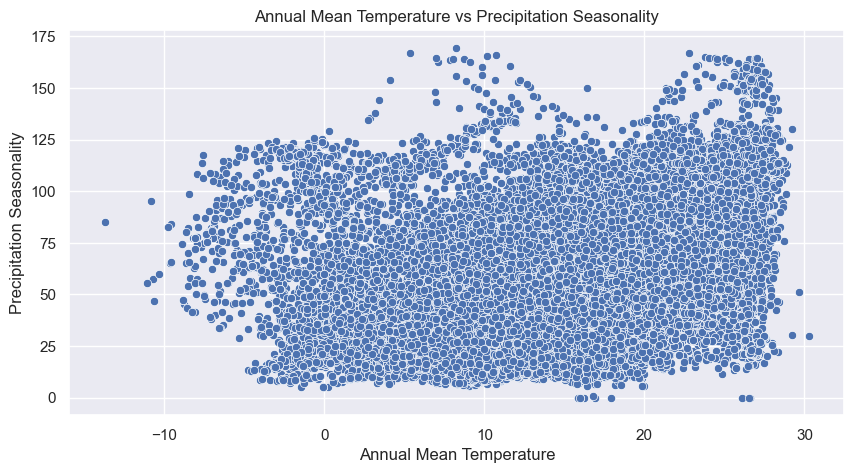

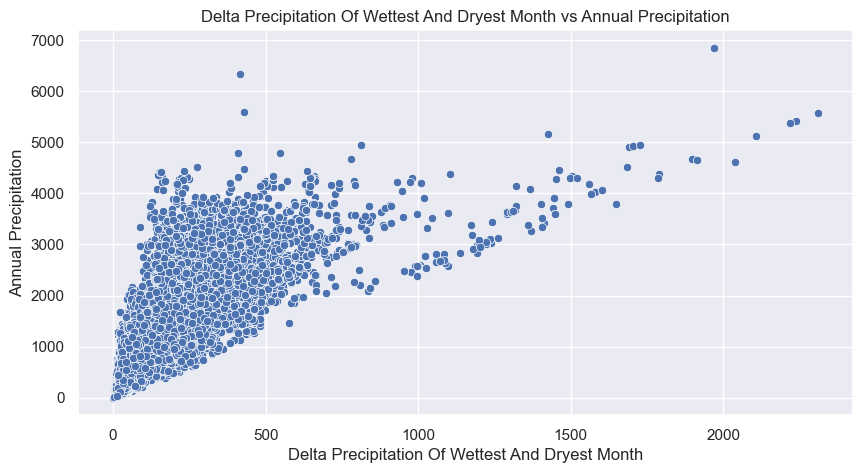

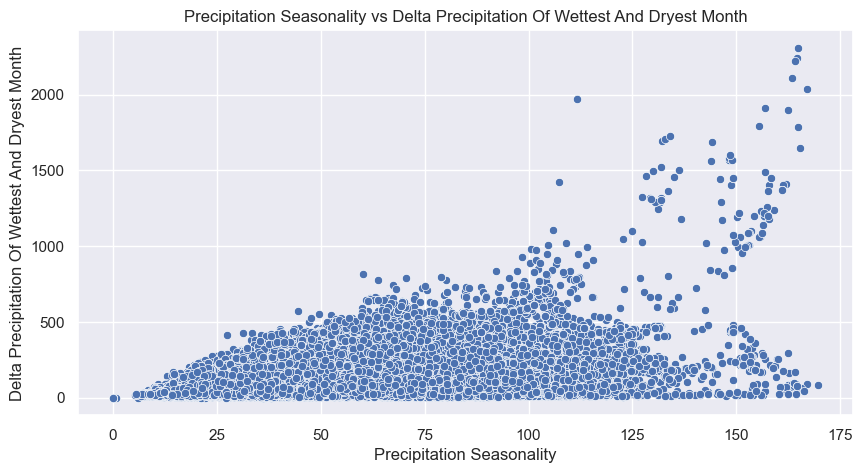

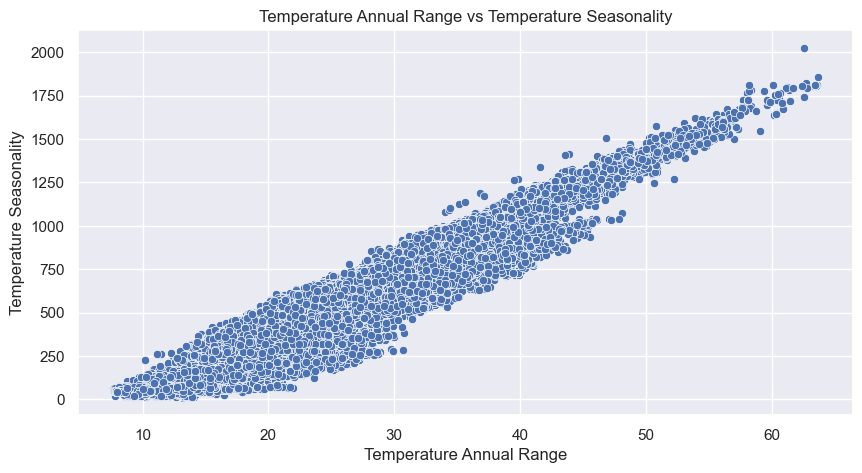

In [59]:
# Set a larger height for better label readability
# plot the correlation matrix
plt.figure(figsize=(20, 20))
sns.heatmap(climate_cols_df.corr(method='spearman'), cmap='coolwarm', fmt=".2f")
plt.title("Correlation matrix of climate variables")
# plt.show()

# For correlation higher than 0.3, plot the scatter plot
for i in range(len(climate_cols_df.columns)):
    for j in range(i + 1, len(climate_cols_df.columns)):
        if climate_cols_df.corr().iloc[i, j] > 0.2:
            plt.figure(figsize=(10, 5))
            titleX = ' '.join(climate_cols_df.columns[i].split('_')[2:]).title()
            titleY = ' '.join(climate_cols_df.columns[j].split('_')[2:]).title()
            #plot the x axis as the variable with the larger range. use sns.scatterplot
            if climate_cols_df[climate_cols_df.columns[i]].max() - climate_cols_df[climate_cols_df.columns[i]].min() < climate_cols_df[climate_cols_df.columns[j]].max() - climate_cols_df[climate_cols_df.columns[j]].min():
                sns.scatterplot(data=climate_cols_df, x=climate_cols_df.columns[i], y=climate_cols_df.columns[j])
                plt.xlabel(titleX)
                plt.ylabel(titleY)
                plt.title(f"{titleX} vs {titleY}")
                # plt.show()
            else:
                sns.scatterplot(data=climate_cols_df, x=climate_cols_df.columns[j], y=climate_cols_df.columns[i])
                plt.xlabel(titleY)
                plt.ylabel(titleX)
                plt.title(f"{titleY} vs {titleX}")
            # plt.show()

plt.show()

# Soil Data Analysis

In [49]:
# Display soil columns
display(soil_cols_df.head())
display(soil_cols_df.info())
display(soil_cols_df.describe().T)

,SOIL_bdod_0.5cm_mean_0.01_deg,SOIL_bdod_100.200cm_mean_0.01_deg,SOIL_bdod_15.30cm_mean_0.01_deg,SOIL_bdod_30.60cm_mean_0.01_deg,SOIL_bdod_5.15cm_mean_0.01_deg,SOIL_bdod_60.100cm_mean_0.01_deg,SOIL_cec_0.5cm_mean_0.01_deg,SOIL_cec_100.200cm_mean_0.01_deg,SOIL_cec_15.30cm_mean_0.01_deg,SOIL_cec_30.60cm_mean_0.01_deg,...,SOIL_silt_15.30cm_mean_0.01_deg,SOIL_silt_30.60cm_mean_0.01_deg,SOIL_silt_5.15cm_mean_0.01_deg,SOIL_silt_60.100cm_mean_0.01_deg,SOIL_soc_0.5cm_mean_0.01_deg,SOIL_soc_100.200cm_mean_0.01_deg,SOIL_soc_15.30cm_mean_0.01_deg,SOIL_soc_30.60cm_mean_0.01_deg,SOIL_soc_5.15cm_mean_0.01_deg,SOIL_soc_60.100cm_mean_0.01_deg
0,139,166,156,163,149,166,356,341,363,362,...,319,302,336,293,455,20,93,50,258,33
1,116,144,130,137,124,142,254,243,227,219,...,349,344,364,351,866,51,216,124,376,75
2,123,146,131,143,129,145,267,181,197,195,...,403,398,459,395,577,53,157,83,306,62
3,134,146,141,144,138,145,174,157,158,163,...,211,192,224,192,177,35,69,48,103,38
4,136,145,141,142,139,143,128,125,128,126,...,164,160,179,163,241,98,129,104,190,130


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51393 entries, 0 to 51392
Data columns (total 61 columns):
 #   Column                                 Non-Null Count  Dtype
---  ------                                 --------------  -----
 0   SOIL_bdod_0.5cm_mean_0.01_deg          51393 non-null  int64
 1   SOIL_bdod_100.200cm_mean_0.01_deg      51393 non-null  int64
 2   SOIL_bdod_15.30cm_mean_0.01_deg        51393 non-null  int64
 3   SOIL_bdod_30.60cm_mean_0.01_deg        51393 non-null  int64
 4   SOIL_bdod_5.15cm_mean_0.01_deg         51393 non-null  int64
 5   SOIL_bdod_60.100cm_mean_0.01_deg       51393 non-null  int64
 6   SOIL_cec_0.5cm_mean_0.01_deg           51393 non-null  int64
 7   SOIL_cec_100.200cm_mean_0.01_deg       51393 non-null  int64
 8   SOIL_cec_15.30cm_mean_0.01_deg         51393 non-null  int64
 9   SOIL_cec_30.60cm_mean_0.01_deg         51393 non-null  int64
 10  SOIL_cec_5.15cm_mean_0.01_deg          51393 non-null  int64
 11  SOIL_cec_60.100cm_mean_0.01_

None

,count,mean,std,min,25%,50%,75%,max
SOIL_bdod_0.5cm_mean_0.01_deg,51393.0,116.899286,17.603880,35.0,106.0,118.0,130.0,194.0
SOIL_bdod_100.200cm_mean_0.01_deg,51393.0,140.260074,15.074673,46.0,131.0,142.0,150.0,192.0
SOIL_bdod_15.30cm_mean_0.01_deg,51393.0,128.191057,16.029811,42.0,118.0,129.0,139.0,201.0
SOIL_bdod_30.60cm_mean_0.01_deg,51393.0,135.104489,15.610920,45.0,126.0,137.0,145.0,185.0
SOIL_bdod_5.15cm_mean_0.01_deg,51393.0,123.125231,16.641302,40.0,112.0,123.0,135.0,204.0
...,...,...,...,...,...,...,...,...
SOIL_soc_100.200cm_mean_0.01_deg,51393.0,155.296383,210.403494,3.0,47.0,87.0,180.0,4350.0
SOIL_soc_15.30cm_mean_0.01_deg,51393.0,265.717082,243.346938,11.0,128.0,200.0,308.0,3298.0
SOIL_soc_30.60cm_mean_0.01_deg,51393.0,192.880801,206.599064,5.0,81.0,132.0,223.0,4114.0
SOIL_soc_5.15cm_mean_0.01_deg,51393.0,382.781099,307.949849,-189.0,186.0,305.0,471.0,3460.0


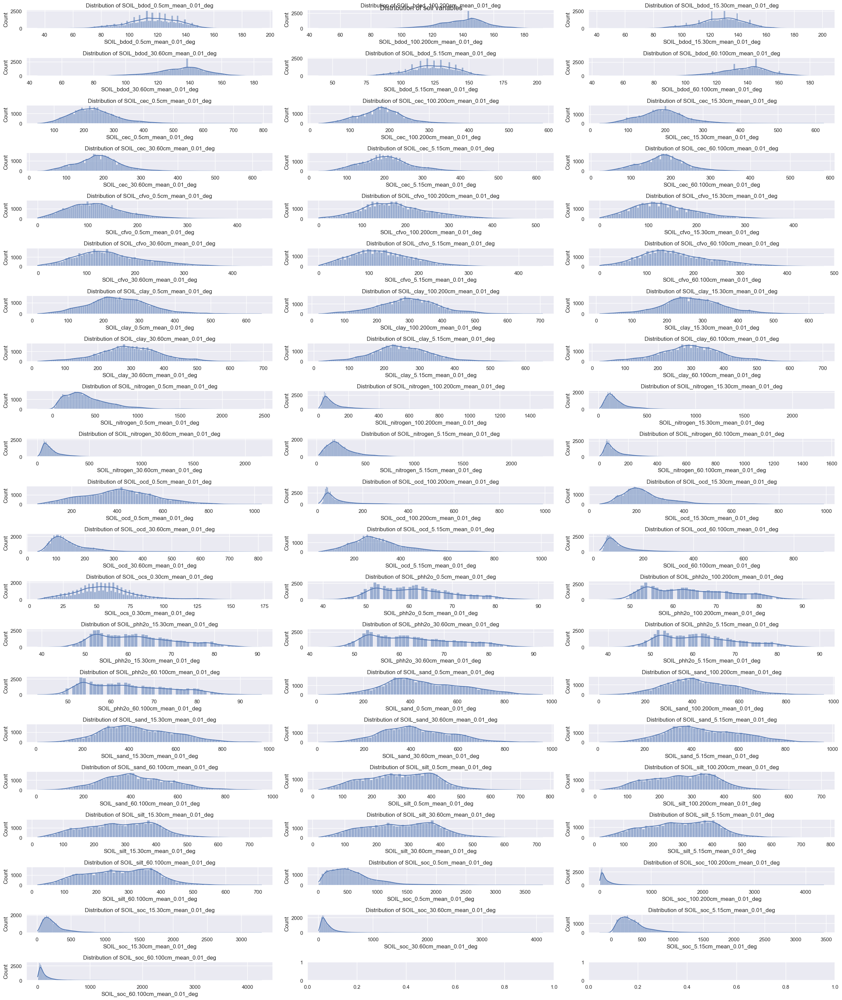

In [54]:
#Distribution of soil variables
import warnings
# just ignore the warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=FutureWarning)

    ncols = 3
    nrows = math.ceil(len(soil_cols_df.columns) / ncols)
    fig, axes = plt.subplots(nrows=nrows, ncols=3, figsize=(25, 30))
    fig.suptitle("Distribution of soil variables")
    for i, target_name in enumerate(soil_cols_df.columns):
        sns.histplot(data=soil_cols_df, x=target_name, ax=axes[i // 3, i % 3], kde=True)
        axes[i // 3, i % 3].set_title(f"Distribution of {target_name}")

    plt.tight_layout()
    plt.show()

Text(40, 12, 'bdod (cg/cm3): bulk density of fine earth \ncec (mmol(c)/kg): cation exchange capacity \ncfvo (cm3/dm3): fraction of coarse fragments \nclay (g/kg): clay content \nnitrogen (cg/kg): total nitrogen \nphh2o (pHx10): soil pH in H2O \nsand (g/kg): sand content \nsilt (g/kg): silt content \nsoc (dg/kg): soil organic carbon \nocd (hg/m3): organic carbon density \nocs (t/ha): organic carbon stock \n')

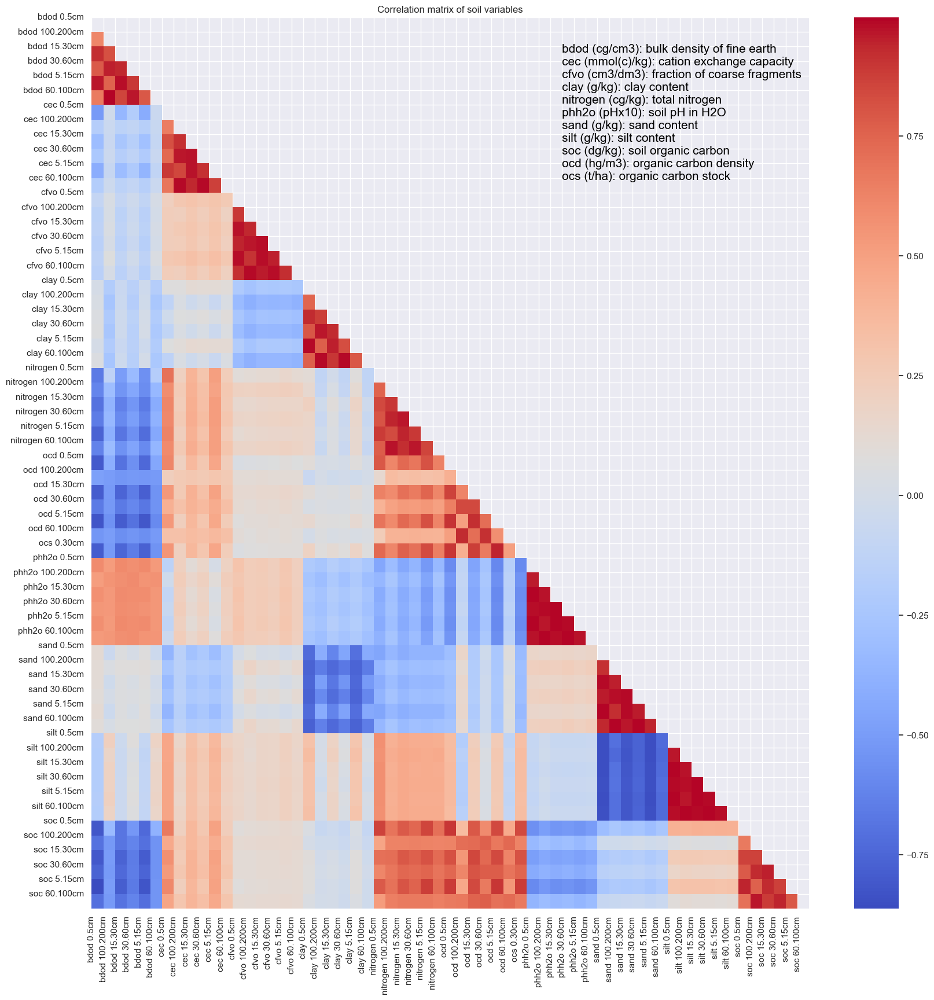

In [104]:
from textwrap import dedent
#Correlation matrix of soil variables
# Set a larger height for better label readability
# plot the correlation matrix
plt.figure(figsize=(20, 20))
sns.heatmap(soil_cols_df.corr(method='spearman'), cmap='coolwarm', fmt=".2f", mask=np.triu(soil_cols_df.corr(method='spearman')))
labels = [' '.join(col.split('_')[1:3]) for col in soil_cols_df.columns]
plt.xticks(ticks=range(len(labels)), labels=labels, rotation=90)
plt.yticks(ticks=range(len(labels)), labels=labels, rotation=0)
plt.title("Correlation matrix of soil variables")
#insert text on plot with label explanation
plt.text(40, 12, dedent("\
         bdod (cg/cm3): bulk density of fine earth \n\
         cec (mmol(c)/kg): cation exchange capacity \n\
         cfvo (cm3/dm3): fraction of coarse fragments \n\
         clay (g/kg): clay content \n\
         nitrogen (cg/kg): total nitrogen \n\
         phh2o (pHx10): soil pH in H2O \n\
         sand (g/kg): sand content \n\
         silt (g/kg): silt content \n\
         soc (dg/kg): soil organic carbon \n\
         ocd (hg/m3): organic carbon density \n\
         ocs (t/ha): organic carbon stock \n\
         "), color='black', fontsize=15, ha='left')
# plt.show()


/var/folders/72/gmyh7n0s30ncrl7rx6bnhlph0000gn/T/ipykernel_1636/704541130.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 5))


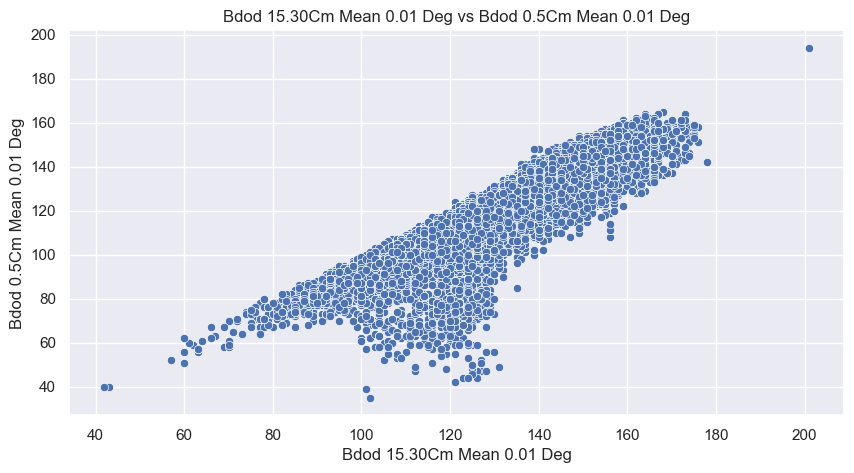

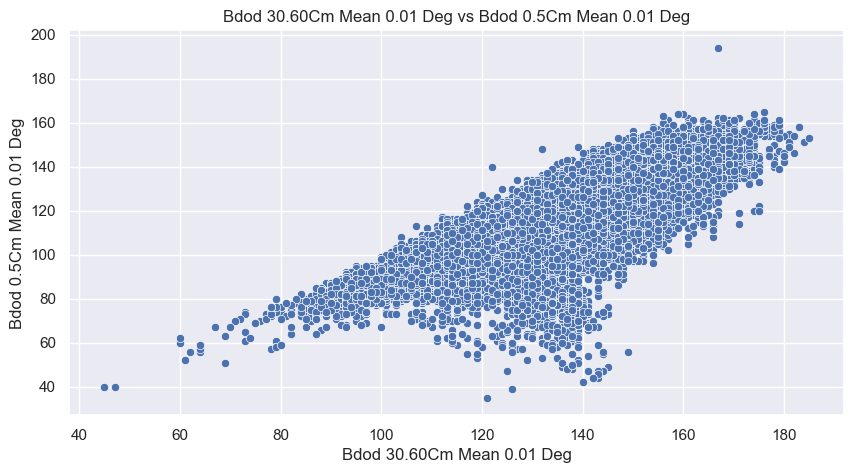

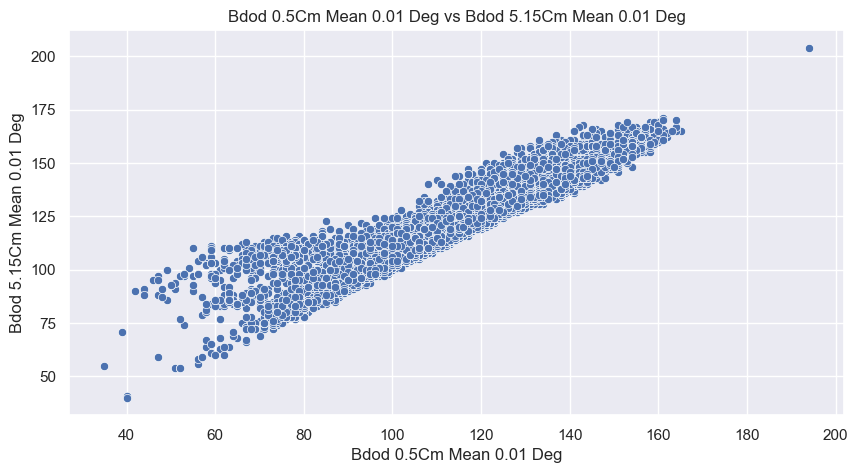

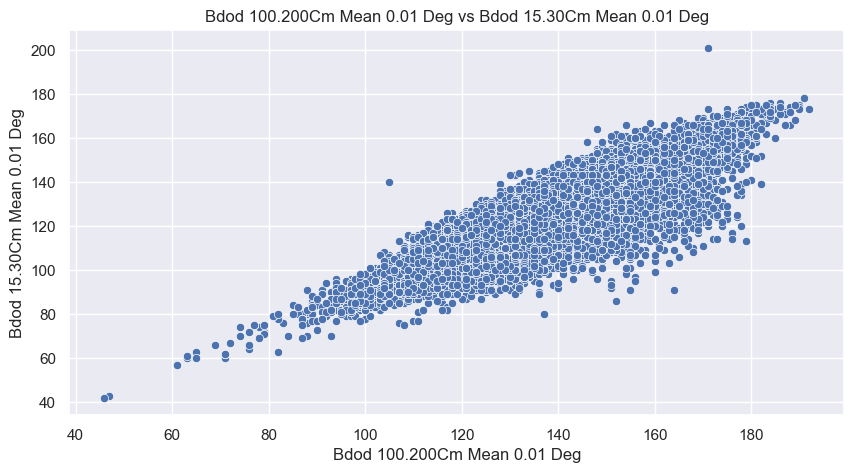

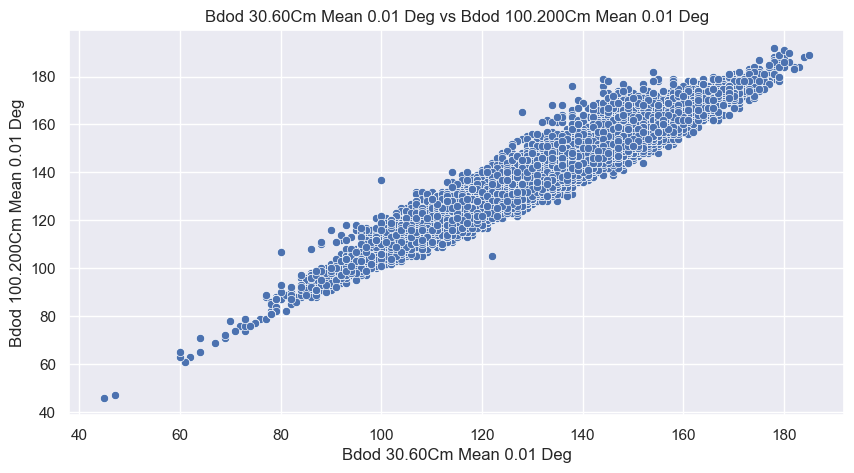

...

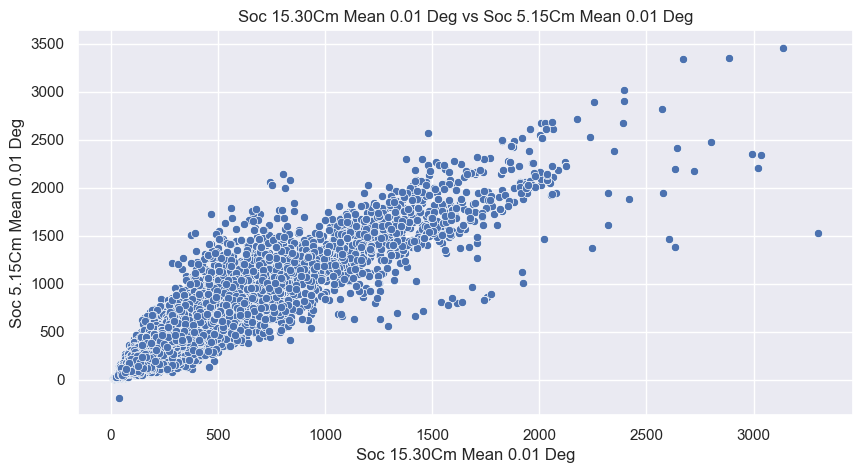

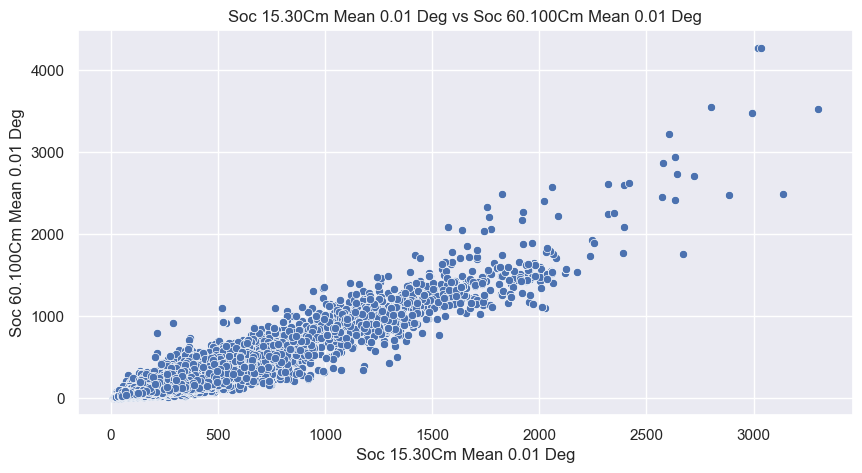

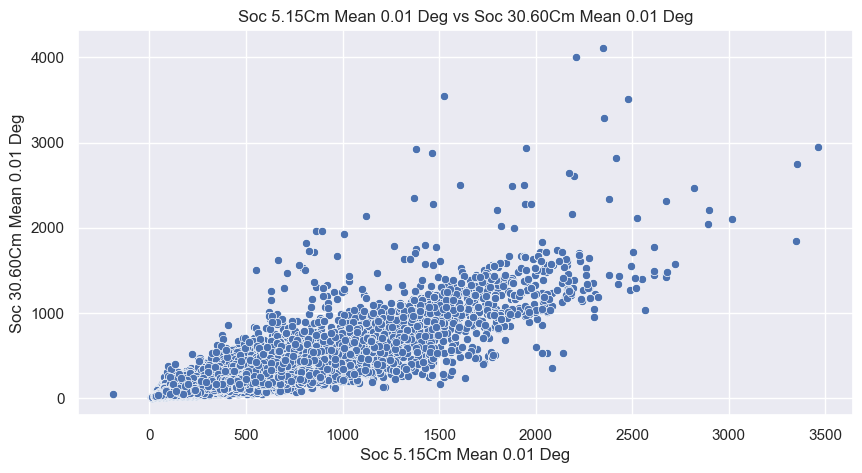

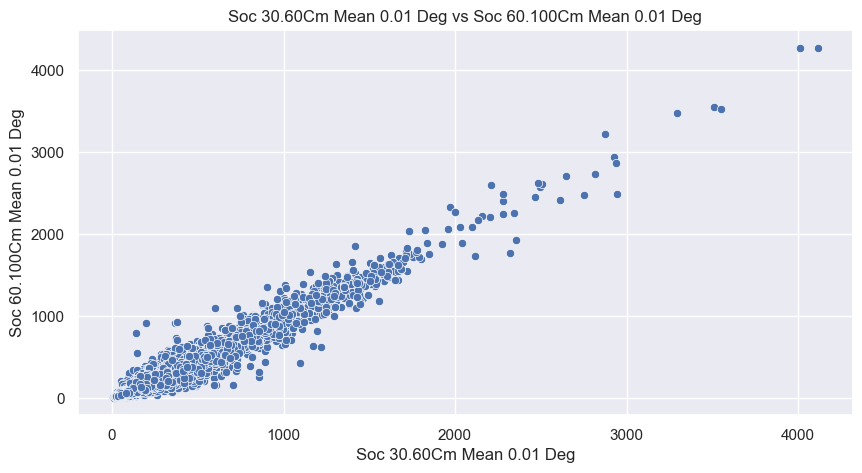

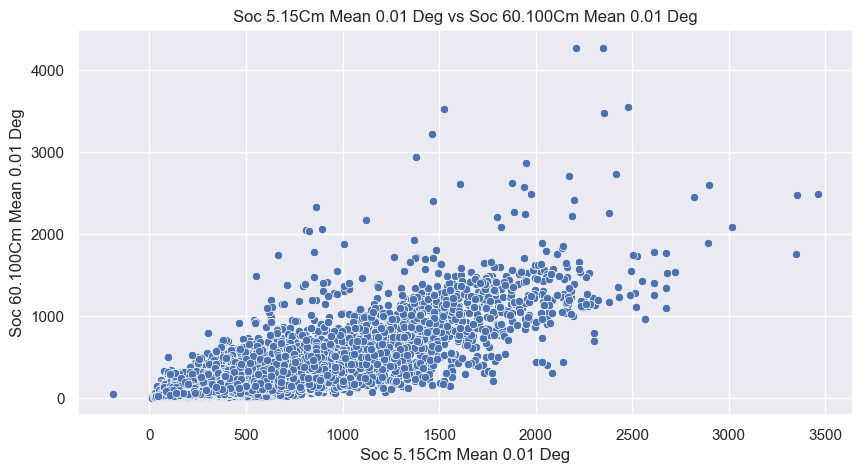

In [61]:

# For correlation higher than 0.3, plot the scatter plot
for i in range(len(soil_cols_df.columns)):
    for j in range(i + 1, len(soil_cols_df.columns)):
        if soil_cols_df.corr().iloc[i, j] > 0.7:
            plt.figure(figsize=(10, 5))
            titleX = ' '.join(soil_cols_df.columns[i].split('_')[1:]).title()
            titleY = ' '.join(soil_cols_df.columns[j].split('_')[1:]).title()
            #plot the x axis as the variable with the larger range. use sns.scatterplot
            if soil_cols_df[soil_cols_df.columns[i]].max() - soil_cols_df[soil_cols_df.columns[i]].min() < soil_cols_df[soil_cols_df.columns[j]].max() - soil_cols_df[soil_cols_df.columns[j]].min():
                sns.scatterplot(data=soil_cols_df, x=soil_cols_df.columns[i], y=soil_cols_df.columns[j])
                plt.xlabel(titleX)
                plt.ylabel(titleY)
                plt.title(f"{titleX} vs {titleY}")
                # plt.show()
            else:
                sns.scatterplot(data=soil_cols_df, x=soil_cols_df.columns[j], y=soil_cols_df.columns[i])
                plt.xlabel(titleY)
                plt.ylabel(titleX)
                plt.title(f"{titleY} vs {titleX}")
            # plt.show()

plt.show()

# MODIS Data Correlation

Text(0.5, 1.0, 'Correlation matrix of MODIS surface reflectance bands')

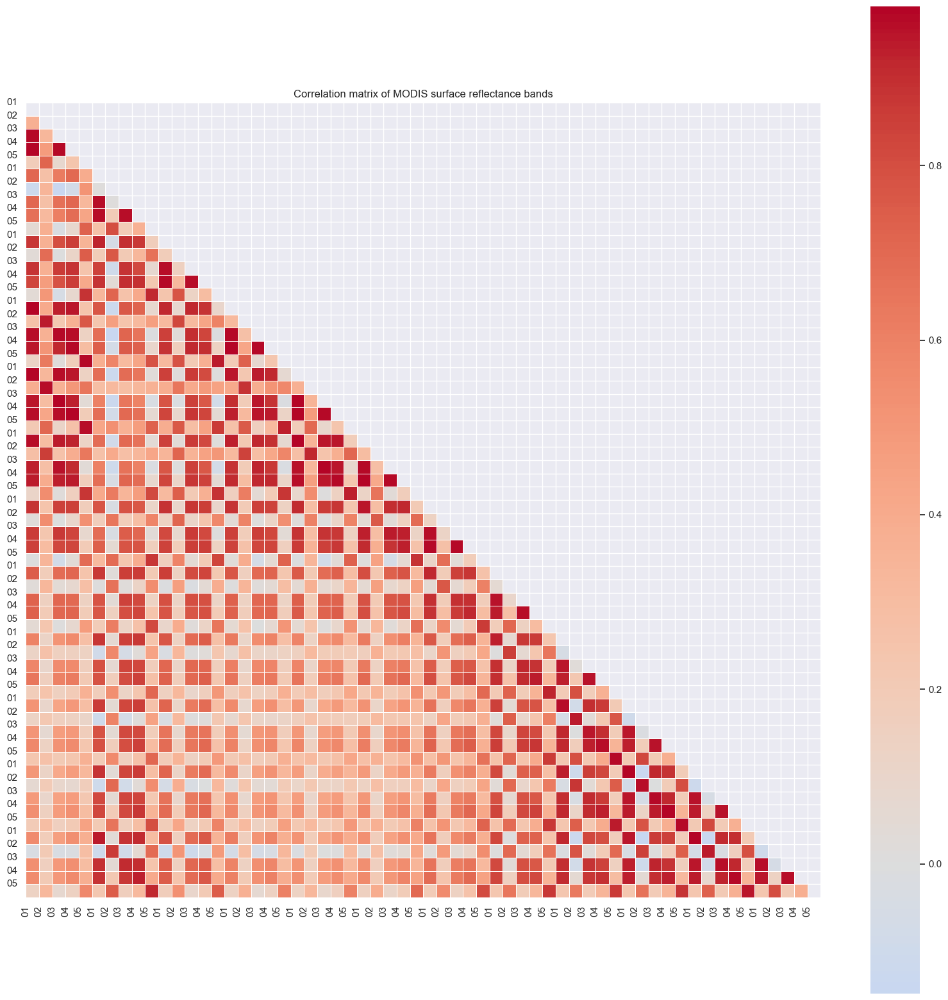

In [78]:
#Correlation matrix of MODIS variables
# Set a larger height for better label readability
# plot the correlation matrix
plt.figure(figsize=(20, 20))
# sns.heatmap(MODIS_cols_df.corr(method='spearman'), cmap='coolwarm', fmt=".2f", mask=np.triu(MODIS_cols_df.corr(method='spearman')))
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(MODIS_cols_df.corr(method='spearman'), cmap='coolwarm', fmt=".2f", mask=np.triu(MODIS_cols_df.corr(method='spearman')), square=True, linewidths=.5, center=0)
#change axis labels
labels = [''.join(col.split('_')[-4]) for col in MODIS_cols_df.columns]
plt.xticks(ticks=np.arange(len(labels)), labels=labels, rotation=90)
plt.yticks(ticks=np.arange(len(labels)), labels=labels, rotation=0)
plt.title("Correlation matrix of MODIS surface reflectance bands")
# plt.show()


In [ ]:

# For correlation higher than 0.3, plot the scatter plot
for i in range(len(MODIS_cols_df.columns)):
    for j in range(i + 1, len(MODIS_cols_df.columns)):
        if MODIS_cols_df.corr().iloc[i, j] > 0.7:
            plt.figure(figsize=(10, 5))
            titleX = ' '.join(MODIS_cols_df.columns[i].split('_')[1:]).title()
            titleY = ' '.join(MODIS_cols_df.columns[j].split('_')[1:]).title()
            #plot the x axis as the variable with the larger range. use sns.scatterplot
            if MODIS_cols_df[MODIS_cols_df.columns[i]].max() - MODIS_cols_df[MODIS_cols_df.columns[i]].min() < MODIS_cols_df[MODIS_cols_df.columns[j]].max() - MODIS_cols_df[MODIS_cols_df.columns[j]].min():
                sns.scatterplot(data=MODIS_cols_df, x=MODIS_cols_df.columns[i], y=MODIS_cols_df.columns[j])
                plt.xlabel(titleX)
                plt.ylabel(titleY)
                plt.title(f"{titleX} vs {titleY}")
                # plt.show()
            else:
                sns.scatterplot(data=MODIS_cols_df, x=MODIS_cols_df.columns[j], y=MODIS_cols_df.columns[i])
                plt.xlabel(titleY)
                plt.ylabel(titleX)
                plt.title(f"{titleY} vs {titleX}")
            # plt.show()

plt.show()

# VOD Data Correlation

Text(0.5, 1.0, 'Correlation matrix of VOD C-, X-, and Ku Frequency Bands for 12 time periods')

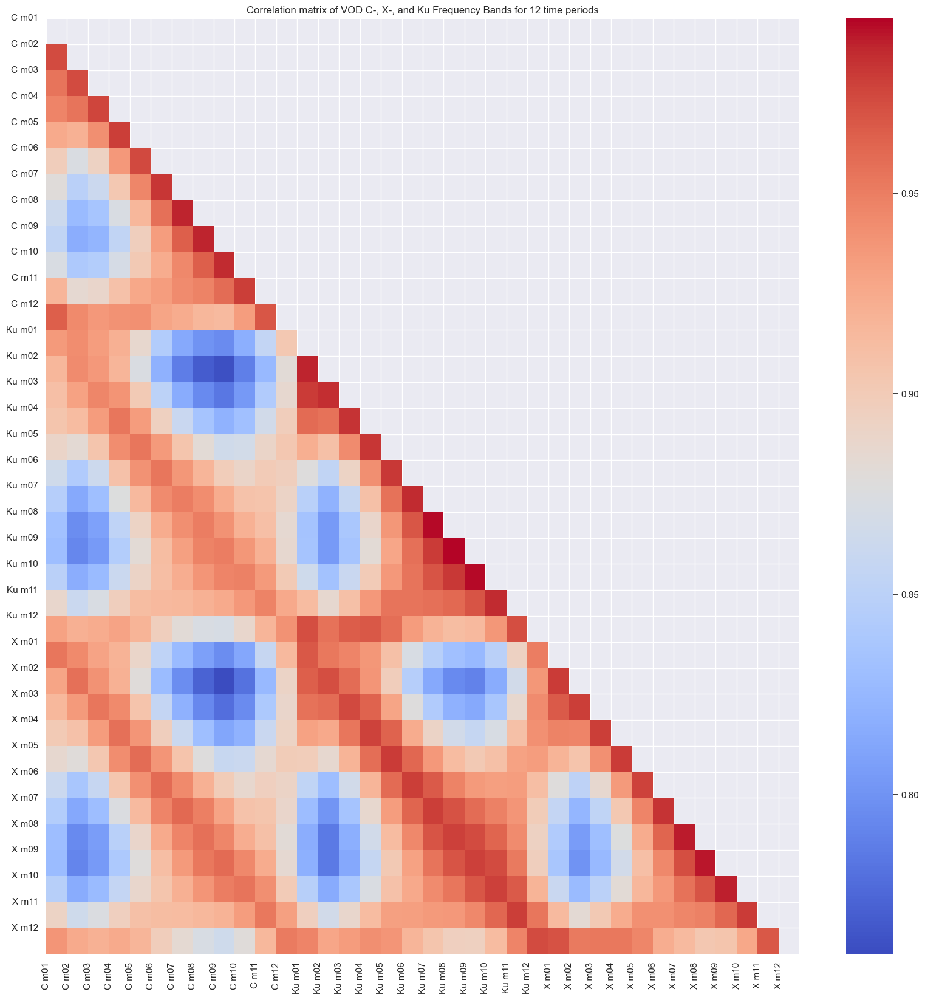

In [122]:
#Correlation matrix of VOD variables
# Set a larger height for better label readability
# plot the correlation matrix
plt.figure(figsize=(20, 20))
# sns.heatmap(VOD_cols_df.corr(method='spearman'), annot=True, cmap='coolwarm', fmt=".2f")
sns.heatmap(VOD_cols_df.corr(method='spearman'), cmap='coolwarm', fmt=".2f", mask=np.triu(VOD_cols_df.corr(method='spearman')))
labels = [' '.join(col.split('_')[1::5]) for col in VOD_cols_df.columns]
plt.xticks(ticks=np.arange(len(labels)), labels=labels, rotation=90)
plt.yticks(ticks=np.arange(len(labels)), labels=labels, rotation=0)
plt.title("Correlation matrix of VOD C-, X-, and Ku Frequency Bands for 12 time periods")
# plt.show()


In [ ]:

# For correlation higher than 0.3, plot the scatter plot
for i in range(len(VOD_cols_df.columns)):
    for j in range(i + 1, len(VOD_cols_df.columns)):
        if VOD_cols_df.corr().iloc[i, j] > 0.5:
            plt.figure(figsize=(10, 5))
            titleX = ' '.join(VOD_cols_df.columns[i].split('_')[1:]).title()
            titleY = ' '.join(VOD_cols_df.columns[j].split('_')[1:]).title()
            #plot the x axis as the variable with the larger range. use sns.scatterplot
            if VOD_cols_df[VOD_cols_df.columns[i]].max() - VOD_cols_df[VOD_cols_df.columns[i]].min() < VOD_cols_df[VOD_cols_df.columns[j]].max() - VOD_cols_df[VOD_cols_df.columns[j]].min():
                sns.scatterplot(data=VOD_cols_df, x=VOD_cols_df.columns[i], y=VOD_cols_df.columns[j])
                plt.xlabel(titleX)
                plt.ylabel(titleY)
                plt.title(f"{titleX} vs {titleY}")
                # plt.show()
            else:
                sns.scatterplot(data=VOD_cols_df, x=VOD_cols_df.columns[j], y=VOD_cols_df.columns[i])
                plt.xlabel(titleY)
                plt.ylabel(titleX)
                plt.title(f"{titleY} vs {titleX}")
            # plt.show()

plt.show()

# Check target columns

In [124]:
# Labels Meta Data
target_name_meta = pd.read_csv('/Users/dlkh/Documents/GitHub/CS5242 Neural Networks/CS5242_plantTraits/data/target_name_meta.tsv', delimiter='\t')
target_name_meta['trait_ID'] = target_name_meta['trait_ID'] + '_mean'
target_name_meta = target_name_meta.set_index('trait_ID').squeeze().to_dict()

display(pd.Series(target_name_meta).to_frame())

,0
X4_mean,Stem specific density (SSD) or wood density (s...
X11_mean,Leaf area per leaf dry mass (specific leaf are...
X18_mean,Plant height
X26_mean,Seed dry mass
X50_mean,Leaf nitrogen (N) content per leaf area
X3112_mean,"Leaf area (in case of compound leaves: leaf, u..."


# Check data distributions

In [125]:
# Percentiles of features to use
percentiles = [
    0.001, 0.01,0.05,0.10,0.25,
    0.50,
    0.75,0.90,0.95,0.99, 0.999,
]
labels_describe_df = pd.DataFrame()
for target in CONFIG.TARGET_COLUMNS:
    labels_describe_df = pd.concat((
        labels_describe_df,
        train[target].describe(percentiles=percentiles).round(3)
    ), axis=1)
    
# Transpose DataFrame
labels_describe_df = labels_describe_df.T
    
# Minimum/Maximum Values
labels_describe_df.insert(4, 'v_min', CONFIG.V_MIN)
labels_describe_df.insert(16, 'v_max', CONFIG.V_MAX)
    
display(labels_describe_df)



,count,mean,std,min,v_min,0.1%,1%,5%,10%,25%,50%,75%,90%,95%,99%,99.9%,v_max,max
X4_mean,51393.0,0.522,1.760000e-01,-2.431,-0.416011,-0.416,0.227,0.304,0.339,0.411,0.508,0.622,0.724,0.796,0.918,1.447,1.446793,4.475000e+00
X11_mean,51393.0,141.735,1.328176e+04,0.000,0.516698,0.517,3.078,4.916,6.455,10.645,15.126,19.691,25.311,30.983,51.257,618.885,618.884844,1.504254e+06
X18_mean,51393.0,15975.172,2.078502e+06,0.000,0.005098,0.005,0.041,0.101,0.162,0.309,0.717,3.584,11.323,17.018,28.565,199.613,199.612717,2.720494e+08
X50_mean,51393.0,14.462,1.409496e+03,0.000,0.056425,0.056,0.486,0.774,0.923,1.173,1.480,1.926,2.494,3.036,4.480,39.876,39.876007,1.597599e+05
X26_mean,51393.0,3124.661,2.172520e+05,0.000,0.001079,0.001,0.011,0.047,0.119,0.559,2.511,14.955,79.011,218.550,1395.933,9667.620,9667.619594,3.106555e+07
X3112_mean,51393.0,428975.777,9.510196e+07,0.000,1.132863,1.133,11.180,42.309,89.349,255.021,726.080,2152.292,4844.885,8200.883,24695.882,453450.026,453450.025900,2.155911e+10


# Plot Outliers

In [126]:
def plot_samples(target, df, n):
    rows = train0.sort_values(target, ascending=False).head(n)
    fig, axes = plt.subplots(1, n, figsize=(5*n, 5))
    plt.suptitle(f'{target} | {target_name_meta[target]}', size=24)
    for ax, (row_idx, row) in zip(axes, rows.iterrows()):
        ax.set_title(f'ID: {row.id}, {target}: {row[target]}', size=12)
        ax.imshow(imageio.imread(row['jpeg_bytes']))
        ax.axis('off')
    plt.show()

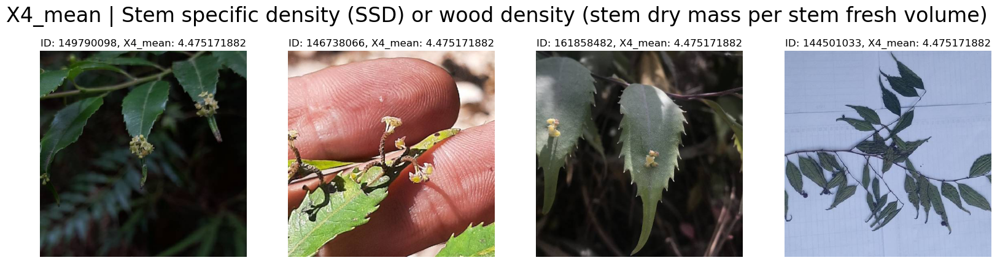

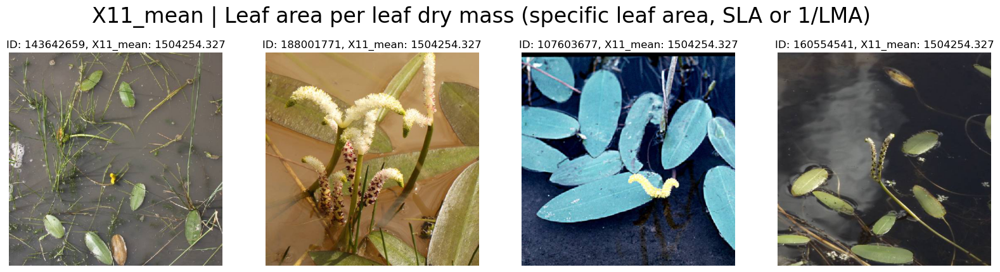

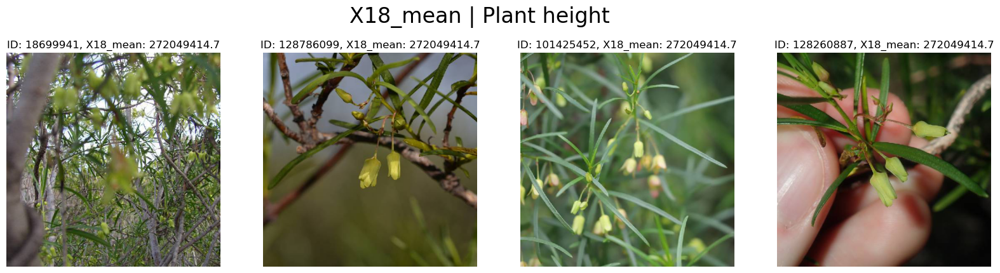

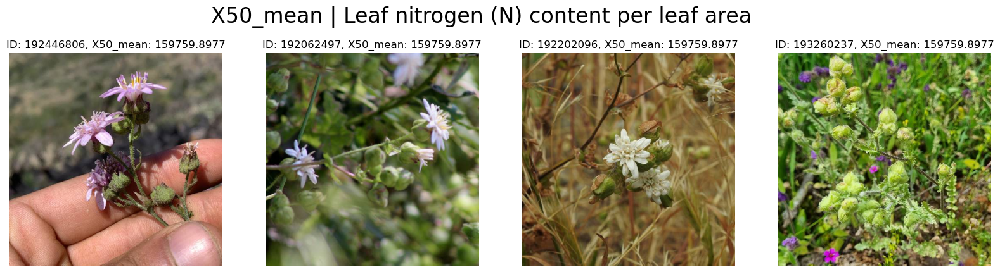

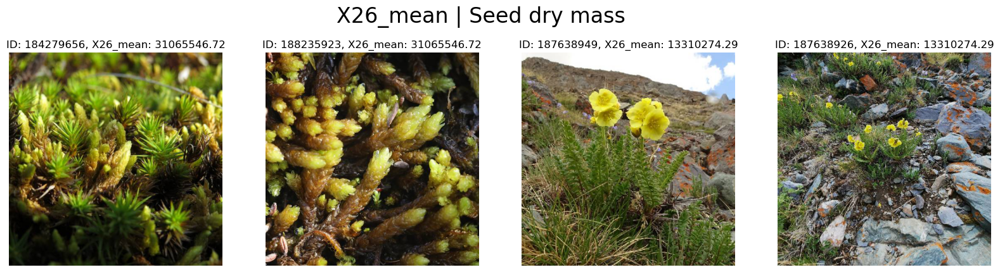

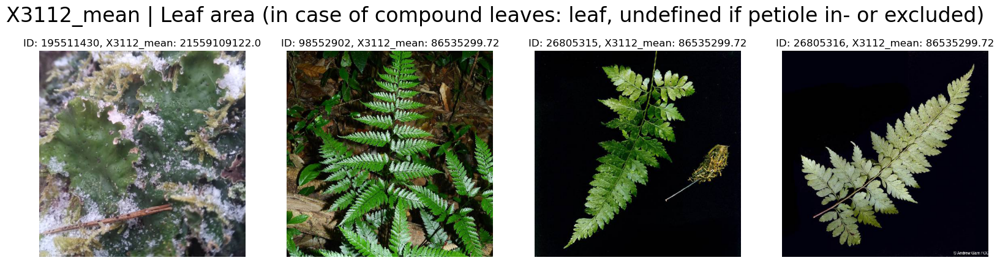

In [12]:
# As can be observer, whatever unit is used, the outliers are comically large
for target in CONFIG.TARGET_COLUMNS:
    plot_samples(target, train, 4)

# Mask outliers

In [127]:
# Mask to exclude values outside of 0.1% - 99.9% range
def get_mask(df):
    lower = []
    higher = []
    mask = np.empty(shape=df[CONFIG.TARGET_COLUMNS].shape, dtype=bool)
    # Fill mask based on minimum/maximum values of sample submission
    for idx, (t, v_min, v_max) in enumerate(zip(CONFIG.TARGET_COLUMNS, CONFIG.V_MIN, CONFIG.V_MAX)):
        labels = df[t].values
        mask[:,idx] = ((labels > v_min) & (labels < v_max))
    return mask.min(axis=1)

# Masks
CONFIG.MASK_TRAIN = get_mask(train)
CONFIG.MASK_VAL = get_mask(val)
# Masked DataFrames
train_mask = train[CONFIG.MASK_TRAIN].reset_index(drop=True)
val_mask = val[CONFIG.MASK_VAL].reset_index(drop=True)
# Add Number Of Steps
CONFIG.N_TRAIN_SAMPLES = len(train_mask)
CONFIG.N_VAL_SAMPLES = len(val_mask)
CONFIG.N_STEPS_PER_EPOCH = (CONFIG.N_TRAIN_SAMPLES // CONFIG.BATCH_SIZE)
CONFIG.N_VAL_STEPS_PER_EPOCH = math.ceil(CONFIG.N_VAL_SAMPLES / CONFIG.BATCH_SIZE_VAL)
CONFIG.N_STEPS = CONFIG.N_STEPS_PER_EPOCH * CONFIG.N_EPOCHS + 1

for m, subset in zip([CONFIG.MASK_TRAIN, CONFIG.MASK_VAL], ['train', 'val']):
    print(f'===== {subset} shape: {m.shape} =====')
    print(f'{subset} \t| # Masked Samples: {(1-m.mean())*CONFIG.N_TRAIN_SAMPLES:.0f}')
    print(f'{subset} \t| % Masked Samples: {100-m.mean()*100:.3f}%')

# Print CONFIG
print(CONFIG.__dict__)

===== train shape: (51393,) =====
train 	| # Masked Samples: 333
train 	| % Masked Samples: 0.652%
===== val shape: (4096,) =====
val 	| # Masked Samples: 262
val 	| % Masked Samples: 0.513%
{'TARGET_MEDIANS': array([5.09009386e-01, 1.51123222e+01, 7.15665064e-01, 1.48006027e+00,
       2.51998457e+00, 7.24431828e+02]), 'N_FEATURES': 163, 'V_MIN': X4_mean      -0.416011
X11_mean      0.516698
X18_mean      0.005098
X50_mean      0.056425
X26_mean      0.001079
X3112_mean    1.132863
Name: 0.001, dtype: float64, 'V_MAX': X4_mean            1.446793
X11_mean         618.884844
X18_mean         199.612717
X50_mean          39.876007
X26_mean        9667.619594
X3112_mean    453450.025900
Name: 0.999, dtype: float64, 'MASK_TRAIN': array([ True,  True,  True, ...,  True,  True,  True]), 'MASK_VAL': array([ True,  True,  True, ...,  True,  True,  True]), 'N_TRAIN_SAMPLES': 51058, 'N_VAL_SAMPLES': 4075, 'N_STEPS_PER_EPOCH': 2127, 'N_VAL_STEPS_PER_EPOCH': 32, 'N_STEPS': 25525}


# Normalise and Scale Data

In [128]:
LOG_FEATURES = ['X11_mean', 'X18_mean', 'X50_mean', 'X26_mean', 'X3112_mean']

# Fill labels using normalization tool
def fill_y(y, df, normalize=False):
    for target_idx, target in enumerate(CONFIG.TARGET_COLUMNS):
        v = df[target]
        if normalize:
            # Log10 Transform
            if target in LOG_FEATURES:
                v = np.log10(v)
            # Shift To Have Zero Median
            Y_SHIFT[target_idx] = np.mean(v)
            v = v - np.median(v)
            # Uniform Variance
            Y_STD[target_idx] = np.std(v)
            v = v / np.std(v)
        # Assign to y_train
        y[:,target_idx] = v

# Feature Scaler
Y_SHIFT = np.zeros(CONFIG.N_TARGETS)
Y_STD = np.zeros(CONFIG.N_TARGETS)
# Masked Labels
y_train_mask_raw = np.zeros_like(train_mask[CONFIG.TARGET_COLUMNS], dtype=np.float32)
y_train_mask = np.zeros_like(train_mask[CONFIG.TARGET_COLUMNS], dtype=np.float32)
y_val_mask = np.zeros_like(val_mask[CONFIG.TARGET_COLUMNS], dtype=np.float32)
# Fill Target Arrays
fill_y(y_train_mask_raw, train_mask, normalize=False)
fill_y(y_train_mask, train_mask, normalize=True)
fill_y(y_val_mask, val_mask, normalize=True)
# Values
display(pd.DataFrame({
    'y_shift': Y_SHIFT,
    'y_std': Y_STD
}, index=CONFIG.TARGET_COLUMNS))

,y_shift,y_std
X4_mean,0.525256,0.151960
X11_mean,1.142098,0.237343
X18_mean,0.008041,0.685711
X50_mean,0.177678,0.180489
X26_mean,0.459768,1.085055
X3112_mean,2.851682,0.674478


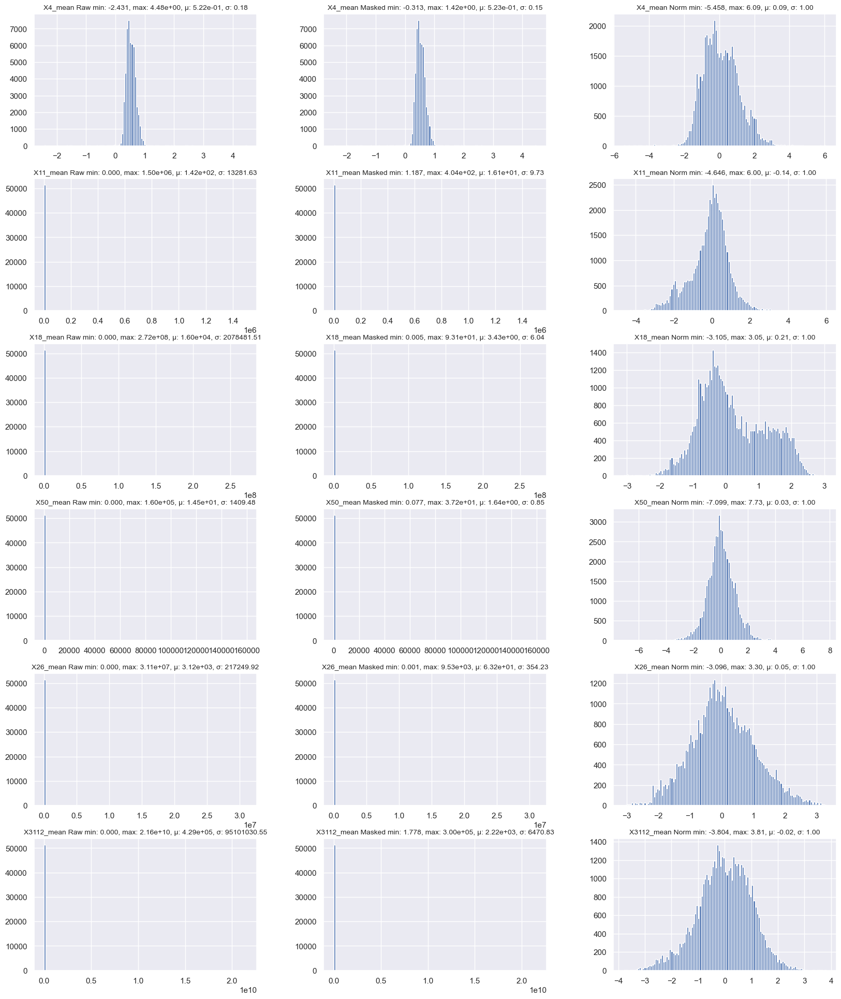

In [129]:
def plot_target_distribution():
    fig, axes = plt.subplots(CONFIG.N_TARGETS, 3, figsize=(20, CONFIG.N_TARGETS*4))
    v_raw = train[CONFIG.TARGET_COLUMNS].values
    for (ax_raw, ax_mask, ax_norm), target, v_r, v_n in zip(axes, CONFIG.TARGET_COLUMNS, v_raw.T, y_train_mask.T):
        # Raw
        ax_raw.hist(v_r, bins=128)
        ax_raw.set_title(f'{target} Raw min: {v_r.min():.3f}, max: {v_r.max():.2e}, µ: {v_r.mean():.2e}, σ: {v_r.std():.2f}', size=10)
        # Masked
        v_m = v_r[CONFIG.MASK_TRAIN]
        ax_mask.hist(v_r, bins=128)
        ax_mask.set_title(f'{target} Masked min: {v_m.min():.3f}, max: {v_m.max():.2e}, µ: {v_m.mean():.2e}, σ: {v_m.std():.2f}', size=10)
        # Normalized
        ax_norm.hist(v_n, bins=128)
        ax_norm.set_title(f'{target} Norm min: {v_n.min():.3f}, max: {v_n.max():.2f}, µ: {v_n.mean():.2f}, σ: {v_n.std():.2f}', size=10)
    plt.subplots_adjust(hspace=0.25, wspace=0.30)
    plt.show()
    
plot_target_distribution()

In [130]:
# Standard Scaler for Features
FEATURE_SCALER = StandardScaler()

# Fit and transform on training features
train_features_mask = FEATURE_SCALER.fit_transform(train_mask[FEATURE_COLUMNS].values.astype(np.float32))
# Transform val/test features using scaler fitted on train data
val_features_mask = FEATURE_SCALER.transform(val_mask[FEATURE_COLUMNS].values.astype(np.float32))
test_features = FEATURE_SCALER.transform(test[FEATURE_COLUMNS].values.astype(np.float32))
# Convert Features to Torch Tensors
train_features_mask = torch.tensor(train_features_mask)
val_features_mask = torch.tensor(val_features_mask)
test_features = torch.tensor(test_features)

# Augment Images

In [131]:
MEAN = np.array([0.485, 0.456, 0.406])
STD = np.array([0.229, 0.224, 0.225])

# Training Augmentations
TRAIN_TRANSFORMS = A.Compose([
        A.RandomSizedCrop(
            [int(0.85*CONFIG.IMAGE_SIZE0), CONFIG.IMAGE_SIZE0],
            CONFIG.IMAGE_SIZE, CONFIG.IMAGE_SIZE, w2h_ratio=1.0, p=1.0
        ),
        A.HorizontalFlip(p=0.50),
        A.RandomBrightnessContrast(brightness_limit=0.10, contrast_limit=0.10, p=0.50),
        A.ImageCompression(quality_lower=75, quality_upper=100, p=0.5),
        ToTensorV2(),
    ])
# Test Augmentations
VAL_TRANSFORMS = A.Compose([
        A.Resize(CONFIG.IMAGE_SIZE,CONFIG.IMAGE_SIZE),
        ToTensorV2(),
    ])

class myDataset(Dataset):
    def __init__(self, X_jpeg_bytes, y, features, transforms=None):
        self.X_jpeg_bytes = X_jpeg_bytes
        self.y = y
        self.features = features
        self.transforms = transforms

    def __len__(self):
        return len(self.X_jpeg_bytes)

    def __getitem__(self, index):
        X_sample = {
            'image': self.transforms(
                    image=imageio.imread(self.X_jpeg_bytes[index]),
                )['image'], 
                'feature': self.features[index],
            }
        y_sample = self.y[index]
        
        return X_sample, y_sample
# Create Datasets and DataLoaders
train_dataset = myDataset(
    train['jpeg_bytes'].values,
    y_train_mask,
    train_features_mask,
    TRAIN_TRANSFORMS,
)

train_dataloader = DataLoader(
        train_dataset,
        batch_size=CONFIG.BATCH_SIZE,
        drop_last=True,
        num_workers=0,
)
train_dataloader_iter = iter(train_dataloader)

val_dataset = myDataset(
    val['jpeg_bytes'].values,
    y_val_mask,
    val_features_mask,
    VAL_TRANSFORMS,
)

val_dataloader = DataLoader(
    val_dataset, 
    batch_size=CONFIG.BATCH_SIZE_VAL, 
    drop_last=False, 
)

test_dataset = myDataset(
    test['jpeg_bytes'].values,
    test['id'].values,
    test_features,
    VAL_TRANSFORMS,
)

# Test image read

In [132]:
# Benchmark Dataset
N = 32
t_start = time.perf_counter_ns()
for _ in tqdm(range(N)):
    next(train_dataloader_iter)
n_images_per_second = (N * CONFIG.BATCH_SIZE) / (time.perf_counter_ns() - t_start) * 1e9
print(f'# Images/Second: {n_images_per_second:.0f}')



# Example batch
X_batch, y_batch = next(train_dataloader_iter)
for k, v in X_batch.items():
    print(f'X_batch {k} shape: {v.shape}, dtype: {v.dtype}')
    print(f'X_batch {k} min: {v.min():.3f}, max: {v.max():.3f}')
    print(f'X_batch {k} µ: {v.float().mean():.3f}, σ: {v.float().std():.3f}')
# Label
print(f'y_batch shape: {y_batch.shape}, dtype: {y_batch.dtype}')
print(f'y_batch min: {y_batch.min():.3f}, max: {y_batch.max():.3f}')
print(f'y_batch µ: {y_batch.mean():.3f}, σ: {y_batch.std():.3f}')

  0%|          | 0/32 [00:00<?, ?it/s]

# Images/Second: 247
X_batch image shape: torch.Size([24, 3, 288, 288]), dtype: torch.uint8
X_batch image min: 0.000, max: 255.000
X_batch image µ: 102.429, σ: 58.724
X_batch feature shape: torch.Size([24, 163]), dtype: torch.float32
X_batch feature min: -2.318, max: 7.694
X_batch feature µ: -0.054, σ: 0.927
y_batch shape: torch.Size([24, 6]), dtype: torch.float32
y_batch min: -2.832, max: 2.861
y_batch µ: -0.036, σ: 0.969


# Check Augmented images

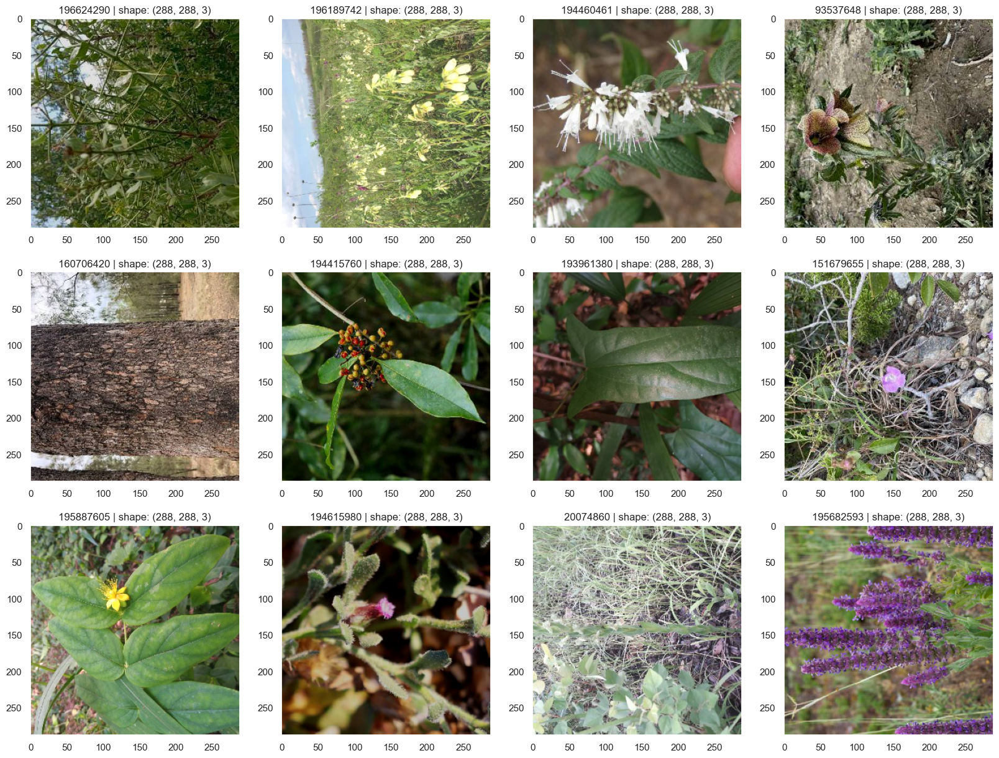

In [148]:
import matplotlib.pyplot as plt
def plot_batch(nrows=3, ncols=4):
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols*5, nrows*5))
    plt.rcParams['axes.grid'] = False
    for r in range(nrows):
        for c in range(ncols):
            idx = (r * ncols) + c
            # Put image on CPU
            img = X_batch['image'][idx].swapaxes(0,2).detach().cpu().numpy()
            # Denormalize Image
            image_id = train['id'][idx]
            axes[r,c].imshow(img)
            axes[r,c].set_title(f'{image_id} | shape: {img.shape}')
    plt.show()
    
plot_batch()